In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../../..')
sys.path.append('../../../hovernet')
sys.path.append('../../../deconvplugin')

import json
import os
import pickle
import torch
import scanpy as sc

PATH = '/home/luca/Documents/data/'

#'/cluster/CBIO/data1/lgortana/'
#'/home/luca/Documents/data/'

# Deconv-plugin predictions

## Load data

In [2]:
# names
adata_name = 'Xenium_FFPE_Human_Breast_Cancer_Rep1'
sim_tag = 'real'

In [3]:
import pandas as pd

data_path = os.path.join(PATH, adata_name)
sim_path = os.path.join(data_path, "sim")

#load images
image_path = os.path.join(data_path, 'pyr_tif', 'Xenium_FFPE_Human_Breast_Cancer_Rep1_he_image.tif')
image_dict = torch.load(os.path.join(sim_path, 'image_dict_64.pt'))

#load ground truth
ground_truth = pd.read_csv(os.path.join(sim_path, f'sim_{adata_name}_gt.csv'), index_col=0)
ground_truth.index = ground_truth.index.astype(str)

In [4]:
#load adata
path_ST_adata = os.path.join(sim_path, f"pseudo_adata_{sim_tag}.h5ad")
adata = sc.read_h5ad(path_ST_adata)

#load spot_dict
path_spot_dict = os.path.join(sim_path, f'spot_dict_{sim_tag}.json')
with open(path_spot_dict, 'r') as f:
    spot_dict = json.load(f)

#load proportions
spot_prop_df = pd.read_csv(os.path.join(sim_path, f'sim_{adata_name}_prop_{sim_tag}.csv'), index_col=0)
spot_prop_df.index = spot_prop_df.index.astype(str)
ct_list = list(spot_prop_df.columns)

#load segmentation
json_path = os.path.join(sim_path, "pannuke_fast_mask_lvl3_annotated.json")
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

#color_dict annotated hovernet
from deconvplugin.basics import generate_color_dict
dict_types_colors = generate_color_dict(ct_list, format='special')
dict_types_colors[f'{len(ct_list)}'] = ['unlabeled', [0, 0, 0, 255]]
dict_types_colors[f'{len(ct_list)+1}'] = ['no_match', [170, 170, 170, 255]]

## Ground truth

In [5]:
from deconvplugin.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


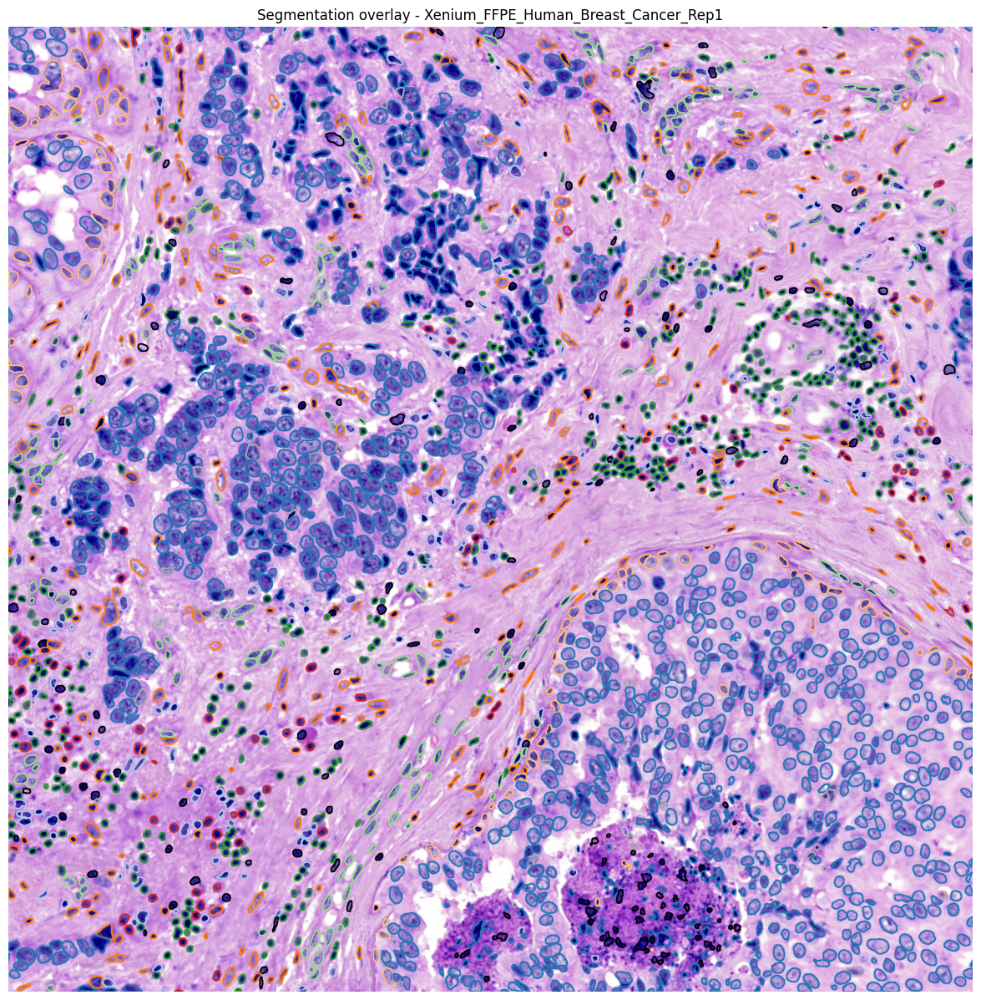

In [6]:
window = ((4500, 14500), (2000, 2000)) #((3000, 20000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=False, display=True)
# fig.savefig("../../data-simulation-xenium/fig/Xenium_humanLung_Cancer_annotated_LuCA2.png", dpi=300, bbox_inches='tight')

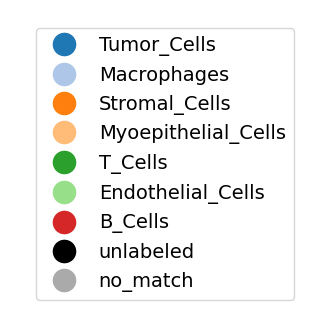

In [7]:
from deconvplugin.analysis.plots import plot_legend

plot_legend(dict_types_colors)

## Model predictions

In [8]:
#load model infos
model_tag = 'model_quick_alpha_0.0_lr_0.0003_weights_False_divergence_l2_beta_1.0_seed_42'
model_dir = os.path.join('../../../models/quick-semi-sim-HB-new-adj', sim_tag, model_tag)

with open(os.path.join(model_dir, 'info.pickle'), 'rb') as f:
    model_info = pickle.load(f)

In [9]:
from deconvplugin.analysis.pred_analyzer import PredAnalyzer

analyzer = PredAnalyzer(model_info=model_info,
                        adjusted=True,
                        ground_truth=ground_truth, 
                        image_dict=image_dict
                        )

Loading predicted labels...
Loading true labels...
Use `add_attributes(seg_dict=your_seg_dict)` to add one.


In [10]:
pd.DataFrame(analyzer.proportions.mean(axis=0)).T

,Tumor_Cells,Macrophages,Stromal_Cells,Myoepithelial_Cells,T_Cells,Endothelial_Cells,B_Cells
0,0.332566,0.080381,0.355514,0.048572,0.082796,0.06605,0.03412


In [11]:
analyzer.add_attributes(adata=adata,
                        adata_name=adata_name,
                        image_path=image_path,
                        seg_dict=hovernet_dict)

In [12]:
from deconvplugin.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        seg_dict=analyzer.seg_dict_w_class,
                        color_dict=analyzer.color_dict)

Visium data found.


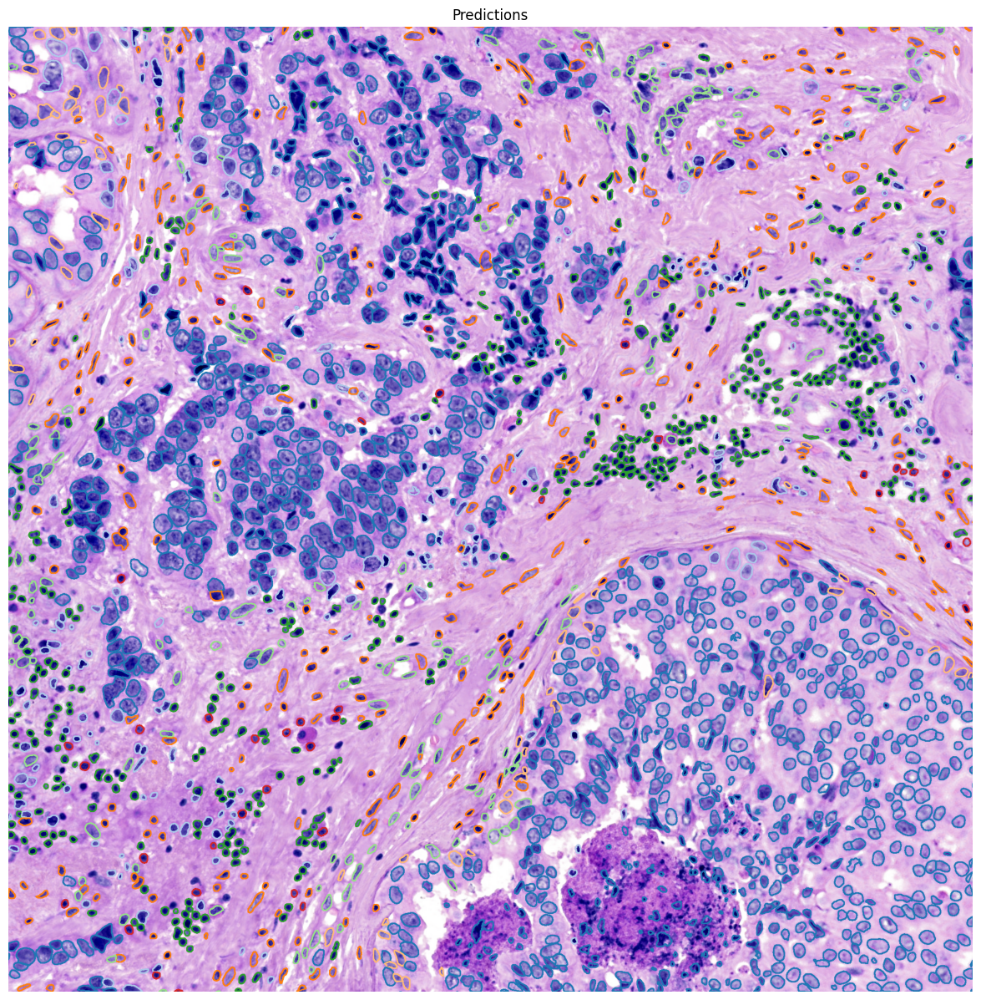

In [13]:
window = ((4500, 14500), (2000, 2000)) #((6000, 20000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=False, display=True, title="Predictions")

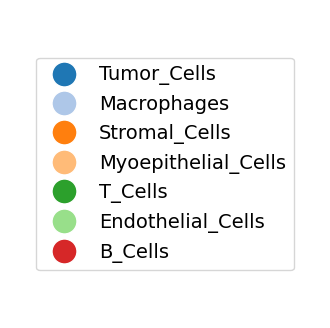

In [14]:
plot_legend(analyzer.color_dict)

# HistoCell predictions

## Load data

In [115]:
slide_name = 'Rep1_256'
seed = 9

In [116]:
#load predictions
histocell_pred = pd.read_csv(f'../../results/HistoCell/{adata_name}/{slide_name}/seed_{seed}/pred_histocell.csv', index_col=0)
histocell_pred.index = histocell_pred.index.astype(str)

#filtered ground_truth
filtered_ground_truth = ground_truth[ground_truth.index.isin(histocell_pred.index)]
filtered_ground_truth = filtered_ground_truth.reindex(histocell_pred.index)

histocell_pred = {'pred_best': histocell_pred}

#load filtered hovernet
json_path = os.path.join(f'../../results/HistoCell/{adata_name}/{slide_name}/seed_{seed}/pannuke_fast_mask_lvl3_annotated_spots.json')
with open(json_path) as json_file:
    filtered_hovernet_dict = json.load(json_file)
    
dict_types_colors = generate_color_dict(ct_list, format='special')
dict_types_colors[f'{len(ct_list)}'] = ['unlabeled', [0, 0, 0, 255]]

## Ground truth
The ground truth is obviously exactly the same but it is filtered so we can compare with the predictions.

In [117]:
from deconvplugin.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=filtered_hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


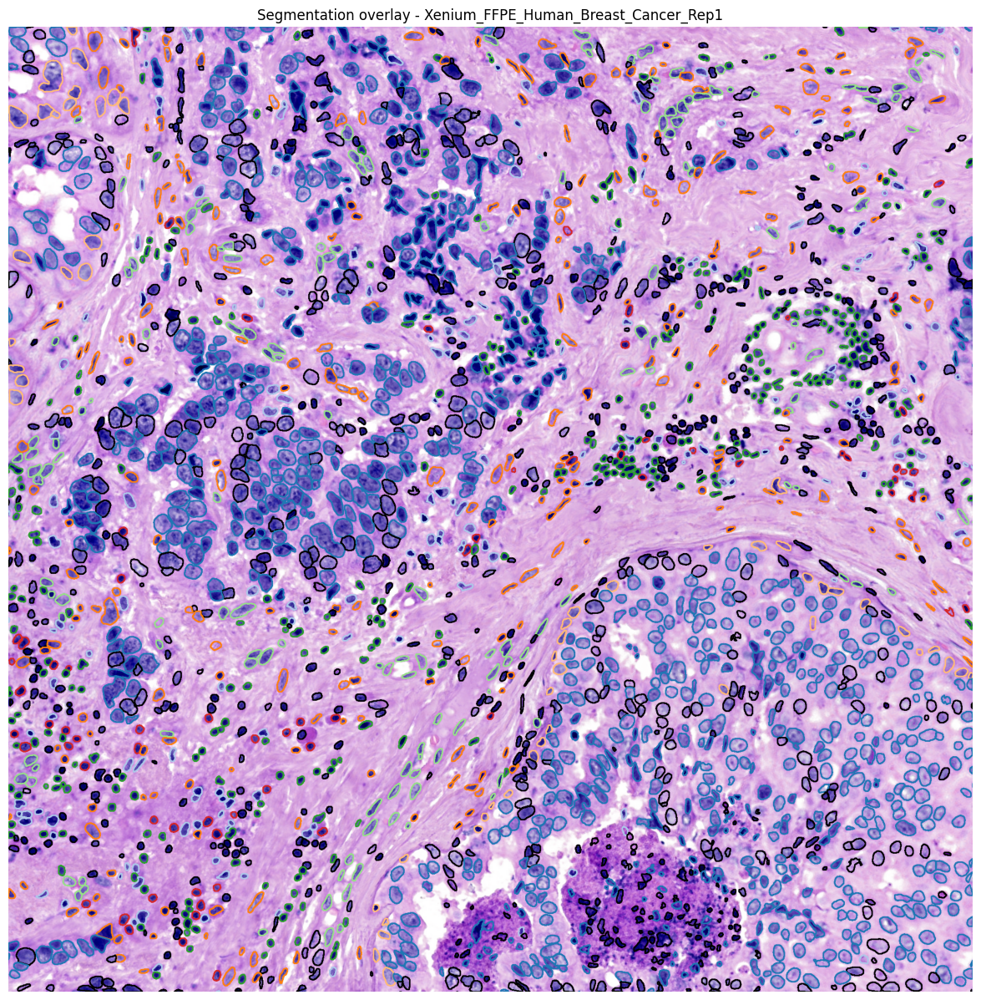

In [118]:
plotter.plot_seg(window=window, show_visium=False, display=True)

Sometimes filtering is very important because HistoCell predicts at tile-level. If tiles focus only on spots, then you have annotated cells exclusively at spot locations.

## Model predictions

In [119]:
analyzer = PredAnalyzer(preds=histocell_pred,
                        spot_dict=spot_dict,
                        proportions=spot_prop_df,
                        adata=adata,
                        adata_name=adata_name,
                        image_path=image_path,
                        seg_dict=filtered_hovernet_dict,
                        ground_truth=filtered_ground_truth, 
                        image_dict=image_dict)

Loading predicted labels...
Loading true labels...
Use `add_attributes(history=your_history)` to add one.


In [120]:
from deconvplugin.analysis.postseg import IntVisualizer

plotter = IntVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        seg_dict=analyzer.seg_dict_w_class,
                        color_dict=analyzer.color_dict)

Visium data found.


In [121]:
plotter.plot_seg(window=window, show_visium=True, display=True, title="HistoCell predictions")

## Compute and save metrics

In [122]:
import os
import csv
import numpy as np
from openpyxl import load_workbook

def compute_statistics(metrics_list):
    """
    Compute mean and confidence intervals for a list of metrics.

    Args:
        metrics_list (List[Dict[str, float]]): List of dictionaries containing metrics from each run.

    Returns:
        Tuple[Dict[str, float], Dict[str, float]]: Tuple containing the mean and confidence intervals for each metric.
    """

    df_metrics = pd.DataFrame(metrics_list)
    mean_values = df_metrics.mean().to_dict()
    std_values = df_metrics.std()
    count_values = df_metrics.count()
    se_values = std_values / np.sqrt(count_values)
    ci_values = {f"{key} ci": 1.96 * se for key, se in se_values.items()}

    return mean_values, ci_values


def save_metrics_to_excel(metrics_dict, seed, excel_path):
    new_row = {'seed': seed, **metrics_dict}

    if os.path.exists(excel_path):
        # Load existing Excel file
        book = load_workbook(excel_path)
        per_run_df = pd.read_excel(excel_path, sheet_name='per_run')
        per_run_df = pd.concat([per_run_df, pd.DataFrame([new_row])], ignore_index=True)

        # Compute summary
        metric_keys = [k for k in new_row.keys() if k != 'seed']
        metric_dicts = per_run_df[metric_keys].to_dict(orient='records')
        mean_vals, ci_vals = compute_statistics(metric_dicts)

        summary_row = {**mean_vals, **ci_vals}
        summary_df = pd.DataFrame([summary_row])

        with pd.ExcelWriter(excel_path, engine='openpyxl', mode='w') as writer:
            # Ensure summary is first sheet
            summary_df.to_excel(writer, sheet_name='summary', index=False)
            per_run_df.to_excel(writer, sheet_name='per_run', index=False)
    else:
        # Create new Excel file
        per_run_df = pd.DataFrame([new_row])
        metric_keys = [k for k in new_row.keys() if k != 'seed']
        metric_dicts = per_run_df[metric_keys].to_dict(orient='records')
        mean_vals, ci_vals = compute_statistics(metric_dicts)
        summary_row = {**mean_vals, **ci_vals}
        summary_df = pd.DataFrame([summary_row])

        with pd.ExcelWriter(excel_path, engine='openpyxl') as writer:
            summary_df.to_excel(writer, sheet_name='summary', index=False)
            per_run_df.to_excel(writer, sheet_name='per_run', index=False)

In [123]:
metric_list = ['Pearson Correlation global', 'Spearman Correlation global', 'MSE global', 'MAE global']

metrics_spots = analyzer.evaluate_spot_predictions_global()
metrics_spots = {k: v for k, v in metrics_spots.items() if k in metric_list}

output_path = os.path.join(f'../../results/HistoCell/{adata_name}/{slide_name}', 'metrics_spots.xlsx')
save_metrics_to_excel(metrics_spots, seed, output_path)

In [124]:
output_path = os.path.join(f'../../results/HistoCell/{adata_name}/{slide_name}', 'metrics.xlsx')

metrics_cells = analyzer.evaluate_cell_predictions(per_class=False)
save_metrics_to_excel(metrics_cells, seed, output_path)